### This notebook is optionally accelerated with a GPU runtime.
### If you would like to use this acceleration, please select the menu option "Runtime" -> "Change runtime type", select "Hardware Accelerator" -> "GPU" and click "SAVE"

----------------------------------------------------------------------

# YOLOP

*Author: Hust Visual Learning Team*

**YOLOP pretrained on the BDD100K dataset**

## Before You Start
To install YOLOP dependencies:

In [11]:
!wget https://raw.githubusercontent.com/hustvl/YOLOP/main/requirements.txt
!pip install -qr requirements.txt  # Install dependencies using the downloaded file

--2025-01-14 14:57:45--  https://raw.githubusercontent.com/hustvl/YOLOP/main/requirements.txt
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 169 [text/plain]
Saving to: ‘requirements.txt’

requirements.txt    100%[===================>]     169  --.-KB/s    in 0s      

2025-01-14 14:57:45 (7.73 MB/s) - ‘requirements.txt’ saved [169/169]

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.7/101.7 kB 4.7 MB/s eta 0:00:00


In [12]:

!pip install -qr https://github.com/hustvl/YOLOP/blob/main/requirements.txt  # install dependencies

ERROR: Invalid requirement: '<!DOCTYPE html>': Expected package name at the start of dependency specifier
    <!DOCTYPE html>
    ^ (from line 7 of https://github.com/hustvl/YOLOP/blob/main/requirements.txt)


## YOLOP: You Only Look Once for Panoptic driving Perception

### Model Description

<img width="800" alt="YOLOP Model" src="https://github.com/hustvl/YOLOP/raw/main/pictures/yolop.png">
&nbsp;

- YOLOP is an efficient multi-task network that can jointly handle three crucial tasks in autonomous driving: object detection, drivable area segmentation and lane detection. And it is also the first to reach real-time on embedded devices while maintaining state-of-the-art level performance on the **BDD100K** dataset.


### Results

#### Traffic Object Detection Result

| Model          | Recall(%) | mAP50(%) | Speed(fps) |
| -------------- | --------- | -------- | ---------- |
| `Multinet`     | 81.3      | 60.2     | 8.6        |
| `DLT-Net`      | 89.4      | 68.4     | 9.3        |
| `Faster R-CNN` | 77.2      | 55.6     | 5.3        |
| `YOLOv5s`      | 86.8      | 77.2     | 82         |
| `YOLOP(ours)`  | 89.2      | 76.5     | 41         |

#### Drivable Area Segmentation Result

| Model         | mIOU(%) | Speed(fps) |
| ------------- | ------- | ---------- |
| `Multinet`    | 71.6    | 8.6        |
| `DLT-Net`     | 71.3    | 9.3        |
| `PSPNet`      | 89.6    | 11.1       |
| `YOLOP(ours)` | 91.5    | 41         |

#### Lane Detection Result

| Model         | mIOU(%) | IOU(%) |
| ------------- | ------- | ------ |
| `ENet`        | 34.12   | 14.64  |
| `SCNN`        | 35.79   | 15.84  |
| `ENet-SAD`    | 36.56   | 16.02  |
| `YOLOP(ours)` | 70.50   | 26.20  |

#### Ablation Studies 1: End-to-end v.s. Step-by-step

| Training_method | Recall(%) | AP(%) | mIoU(%) | Accuracy(%) | IoU(%) |
| --------------- | --------- | ----- | ------- | ----------- | ------ |
| `ES-W`          | 87.0      | 75.3  | 90.4    | 66.8        | 26.2   |
| `ED-W`          | 87.3      | 76.0  | 91.6    | 71.2        | 26.1   |
| `ES-D-W`        | 87.0      | 75.1  | 91.7    | 68.6        | 27.0   |
| `ED-S-W`        | 87.5      | 76.1  | 91.6    | 68.0        | 26.8   |
| `End-to-end`    | 89.2      | 76.5  | 91.5    | 70.5        | 26.2   |

#### Ablation Studies 2: Multi-task v.s. Single task

| Training_method | Recall(%) | AP(%) | mIoU(%) | Accuracy(%) | IoU(%) | Speed(ms/frame) |
| --------------- | --------- | ----- | ------- | ----------- | ------ | --------------- |
| `Det(only)`     | 88.2      | 76.9  | -       | -           | -      | 15.7            |
| `Da-Seg(only)`  | -         | -     | 92.0    | -           | -      | 14.8            |
| `Ll-Seg(only)`  | -         | -     | -       | 79.6        | 27.9   | 14.8            |
| `Multitask`     | 89.2      | 76.5  | 91.5    | 70.5        | 26.2   | 24.4            |

**Notes**:

- In table 4, E, D, S and W refer to Encoder, Detect head, two Segment heads and whole network. So the Algorithm (First, we only train Encoder and Detect head. Then we freeze the Encoder and Detect head as well as train two Segmentation heads. Finally, the entire network is trained jointly for all three tasks.) can be marked as ED-S-W, and the same for others.

### Visualization

#### Traffic Object Detection Result

<img width="800" alt="Traffic Object Detection Result" src="https://github.com/hustvl/YOLOP/raw/main/pictures/detect.png">
&nbsp;

#### Drivable Area Segmentation Result

<img width="800" alt="Drivable Area Segmentation Result" src="https://github.com/hustvl/YOLOP/raw/main/pictures/da.png">
&nbsp;

#### Lane Detection Result

<img width="800" alt="Lane Detection Result" src="https://github.com/hustvl/YOLOP/raw/main/pictures/ll.png">
&nbsp;

**Notes**:

- The visualization of lane detection result has been post processed by quadratic fitting.

### Deployment

Our model can reason in real-time on **Jetson Tx2**, with **Zed Camera** to capture image. We use **TensorRT** tool for speeding up. We provide code for deployment and reasoning of model in [github code](https://github.com/hustvl/YOLOP/tree/main/toolkits/deploy).


### Load From PyTorch Hub
This example loads the pretrained **YOLOP** model and passes an image for inference.

In [7]:
!pip install prefetch_generator

  Preparing metadata (setup.py) ... done
  Created wheel for prefetch_generator: filename=prefetch_generator-1.0.3-py3-none-any.whl size=4758 sha256=4a58141e1e1d5a15547caaf61b087f6410c418da9320a14f1342ee8ca3ce51d4
  Stored in directory: /root/.cache/pip/wheels/65/65/44/ed059bc23eeda93cfb19b58113423882cd9febae7ebf3f9ddf
Successfully built prefetch_generator


In [9]:
!pip install yacs  # Install the missing 'yacs' package

In [10]:
import torch

# load model
model = torch.hub.load('hustvl/yolop', 'yolop', pretrained=True)

#inference
img = torch.randn(1,3,640,640)
det_out, da_seg_out,ll_seg_out = model(img)

Using cache found in /root/.cache/torch/hub/hustvl_yolop_main
/root/.cache/torch/hub/hustvl_yolop_main/hubconf.py:23: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoin

In [14]:
import cv2
import torch

# Load the pre-trained YOLOP model
model = torch.hub.load('hustvl/yolop', 'yolop', pretrained=True)

# Path to the input video
input_video_path = "/content/lane.mp4"

# Open the video file
cap = cv2.VideoCapture(input_video_path)
if not cap.isOpened():
    print("Error: Could not open the video file.")
    exit()

# Get video properties
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(cap.get(cv2.CAP_PROP_FPS))

# Output video writer
output_video_path = "output_with_lane_detection.mp4"
out = cv2.VideoWriter(output_video_path, cv2.VideoWriter_fourcc(*'mp4v'), fps, (frame_width, frame_height))

# Process the video frame by frame
while True:
    ret, frame = cap.read()
    if not ret:
        break  # End of video

    # Prepare the frame for the model (resize to 640x640)
    resized_frame = cv2.resize(frame, (640, 640))
    img = torch.from_numpy(resized_frame).permute(2, 0, 1).unsqueeze(0).float() / 255.0

    # Perform inference
    with torch.no_grad():
        det_out, da_seg_out, ll_seg_out = model(img)

    # Process the lane detection output (ll_seg_out) for visualization
    ll_seg_out = ll_seg_out.squeeze().cpu().numpy() * 255  # Convert to grayscale

    # Check if ll_seg_out has valid dimensions before resizing
    if ll_seg_out.ndim == 2 and ll_seg_out.shape[0] > 0 and ll_seg_out.shape[1] > 0:
        ll_seg_out = cv2.resize(ll_seg_out, (frame_width, frame_height))  # Resize back to original frame size
    else:
        print("Warning: Skipping frame due to invalid ll_seg_out dimensions.")
        continue  # Skip the current frame

    # Overlay lane detection on the original frame
    ll_seg_colored = cv2.applyColorMap(ll_seg_out.astype('uint8'), cv2.COLORMAP_JET)
    overlaid_frame = cv2.addWeighted(frame, 0.8, ll_seg_colored, 0.2, 0)

    # Write the frame to the output video
    out.write(overlaid_frame)

    # Optional: Display the frame (press 'q' to quit early)
    cv2.imshow("Lane Detection", overlaid_frame)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release resources
cap.release()
out.release()
cv2.destroyAllWindows()

print(f"Processed video saved as {output_video_path}")

Using cache found in /root/.cache/torch/hub/hustvl_yolop_main
/root/.cache/torch/hub/hustvl_yolop_main/hubconf.py:23: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoin

KeyboardInterrupt: 

In [15]:
import cv2
import torch

# Load the pre-trained YOLOP model
model = torch.hub.load('hustvl/yolop', 'yolop', pretrained=True)

# Path to the input video
input_video_path = "/content/nD_20.mp4"

# Open the video file
cap = cv2.VideoCapture(input_video_path)
if not cap.isOpened():
    print("Error: Could not open the video file.")
    exit()

# Get video properties
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(cap.get(cv2.CAP_PROP_FPS))

# Output video writer
output_video_path = "output_with_lane_detection.mp4"
out = cv2.VideoWriter(output_video_path, cv2.VideoWriter_fourcc(*'mp4v'), fps, (frame_width, frame_height))

# Process the video frame by frame
while True:
    ret, frame = cap.read()
    if not ret:
        break  # End of video

    # Prepare the frame for the model (resize to 640x640)
    resized_frame = cv2.resize(frame, (640, 640))
    img = torch.from_numpy(resized_frame).permute(2, 0, 1).unsqueeze(0).float() / 255.0

    # Perform inference
    with torch.no_grad():
        det_out, da_seg_out, ll_seg_out = model(img)

    # Process the lane detection output (ll_seg_out) for visualization
    ll_seg_out = ll_seg_out.squeeze().cpu().numpy() * 255  # Convert to grayscale

    # Check if ll_seg_out has valid dimensions before resizing
    if ll_seg_out.ndim == 2 and ll_seg_out.shape[0] > 0 and ll_seg_out.shape[1] > 0:
        ll_seg_out = cv2.resize(ll_seg_out, (frame_width, frame_height))  # Resize back to original frame size
    else:
        print("Warning: Skipping frame due to invalid ll_seg_out dimensions.")
        continue  # Skip the current frame

    # Overlay lane detection on the original frame
    ll_seg_colored = cv2.applyColorMap(ll_seg_out.astype('uint8'), cv2.COLORMAP_JET)
    overlaid_frame = cv2.addWeighted(frame, 0.8, ll_seg_colored, 0.2, 0)

    # Write the frame to the output video
    out.write(overlaid_frame)

    # Optional: Display the frame (press 'q' to quit early)
    cv2.imshow("Lane Detection", overlaid_frame)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release resources
cap.release()
out.release()
cv2.destroyAllWindows()

print(f"Processed video saved as {output_video_path}")

Using cache found in /root/.cache/torch/hub/hustvl_yolop_main
/root/.cache/torch/hub/hustvl_yolop_main/hubconf.py:23: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoin

KeyboardInterrupt: 

In [16]:
import cv2
import torch

# Load the pre-trained YOLOP model
model = torch.hub.load('hustvl/yolop', 'yolop', pretrained=True)

# Path to the input video
input_video_path = "/content/nD_20.mp4"

# Open the video file
cap = cv2.VideoCapture(input_video_path)
if not cap.isOpened():
    print("Error: Could not open the video file.")
    exit()

# Get video properties
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(cap.get(cv2.CAP_PROP_FPS))

# Output video writer
output_video_path = "output_with_lane_detection11.mp4"
out = cv2.VideoWriter(output_video_path, cv2.VideoWriter_fourcc(*'mp4v'), fps, (frame_width, frame_height))

# Process the video frame by frame
while True:
    ret, frame = cap.read()
    if not ret:
        break  # End of video

    # Prepare the frame for the model (resize to 640x640)
    resized_frame = cv2.resize(frame, (640, 640))
    img = torch.from_numpy(resized_frame).permute(2, 0, 1).unsqueeze(0).float() / 255.0

    # Perform inference
    with torch.no_grad():
        det_out, da_seg_out, ll_seg_out = model(img)

    # Process the lane detection output (ll_seg_out) for visualization
    ll_seg_out = ll_seg_out.squeeze().cpu().numpy() * 255  # Convert to grayscale

    # Check if ll_seg_out has valid dimensions before resizing
    if ll_seg_out.ndim == 2 and ll_seg_out.shape[0] > 0 and ll_seg_out.shape[1] > 0:
        ll_seg_out = cv2.resize(ll_seg_out, (frame_width, frame_height))  # Resize back to original frame size
    else:
        print("Warning: Skipping frame due to invalid ll_seg_out dimensions.")
        continue  # Skip the current frame

    # Overlay lane detection on the original frame
    ll_seg_colored = cv2.applyColorMap(ll_seg_out.astype('uint8'), cv2.COLORMAP_JET)
    overlaid_frame = cv2.addWeighted(frame, 0.8, ll_seg_colored, 0.2, 0)

    # Write the frame to the output video
    out.write(overlaid_frame)

    # Optional: Display the frame (press 'q' to quit early)
    cv2.imshow("Lane Detection", overlaid_frame)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release resources
cap.release()
out.release()
cv2.destroyAllWindows()

print(f"Processed video saved as {output_video_path}")

Using cache found in /root/.cache/torch/hub/hustvl_yolop_main
/root/.cache/torch/hub/hustvl_yolop_main/hubconf.py:23: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoin

Processed video saved as output_with_lane_detection11.mp4


In [20]:
import cv2
import torch

# Load the pre-trained YOLOP model
model = torch.hub.load('hustvl/yolop', 'yolop', pretrained=True)

# Path to the input video
input_video_path = "/content/nD_20.mp4"

# Open the video file
cap = cv2.VideoCapture(input_video_path)
if not cap.isOpened():
    print("Error: Could not open the video file.")
    exit()

# Get video properties
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(cap.get(cv2.CAP_PROP_FPS))

# Output video writer
output_video_path = "output_with_lane_detection.mp4"
out = cv2.VideoWriter(output_video_path, cv2.VideoWriter_fourcc(*'mp4v'), fps, (frame_width, frame_height))

# Process the video frame by frame
while True:
    ret, frame = cap.read()
    if not ret:
        break  # End of video

    # Prepare the frame for the model (resize to 640x640)
    resized_frame = cv2.resize(frame, (640, 640))
    img = torch.from_numpy(resized_frame).permute(2, 0, 1).unsqueeze(0).float() / 255.0

    # Perform inference
    with torch.no_grad():
        det_out, da_seg_out, ll_seg_out = model(img)

    # Process the lane detection output (ll_seg_out) for visualization
    ll_seg_out = ll_seg_out.squeeze().cpu().numpy() * 255  # Convert to grayscale

    #Select the first channel (index 0) of 1l_seg_out
    ll_seg_out = ll_seg_out[0]  # Assuming the first channel represents lane detection

    # Print the shape and dimensions of ll_seg_out for debugging
    print("Shape of ll_seg_out:", ll_seg_out.shape)
    print("Number of dimensions:", ll_seg_out.ndim)

    # Check if ll_seg_out has valid dimensions before resizing
    if ll_seg_out.ndim == 2 and ll_seg_out.shape[0] > 0 and ll_seg_out.shape[1] > 0:
        ll_seg_out = cv2.resize(ll_seg_out, (frame_width, frame_height))  # Resize back to original frame size
    else:
        print("Warning: Skipping frame due to invalid ll_seg_out dimensions.")
        continue  # Skip the current frame

    # Overlay lane detection on the original frame
    ll_seg_colored = cv2.applyColorMap(ll_seg_out.astype('uint8'), cv2.COLORMAP_JET)
    overlaid_frame = cv2.addWeighted(frame, 0.8, ll_seg_colored, 0.2, 0)

    # Write the frame to the output video
    out.write(overlaid_frame)

    # Optional: Display the frame (press 'q' to quit early)
    cv2.imshow("Lane Detection", overlaid_frame)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release resources
cap.release()
out.release()
cv2.destroyAllWindows()

print(f"Processed video saved as {output_video_path}")

Using cache found in /root/.cache/torch/hub/hustvl_yolop_main
/root/.cache/torch/hub/hustvl_yolop_main/hubconf.py:23: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoin

Shape of ll_seg_out: (640, 640)
Number of dimensions: 2


DisabledFunctionError: cv2.imshow() is disabled in Colab, because it causes Jupyter sessions
to crash; see https://github.com/jupyter/notebook/issues/3935.
As a substitution, consider using
  from google.colab.patches import cv2_imshow


Using cache found in /root/.cache/torch/hub/hustvl_yolop_main
/root/.cache/torch/hub/hustvl_yolop_main/hubconf.py:23: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoin

Shape of ll_seg_out: (640, 640)
Number of dimensions: 2


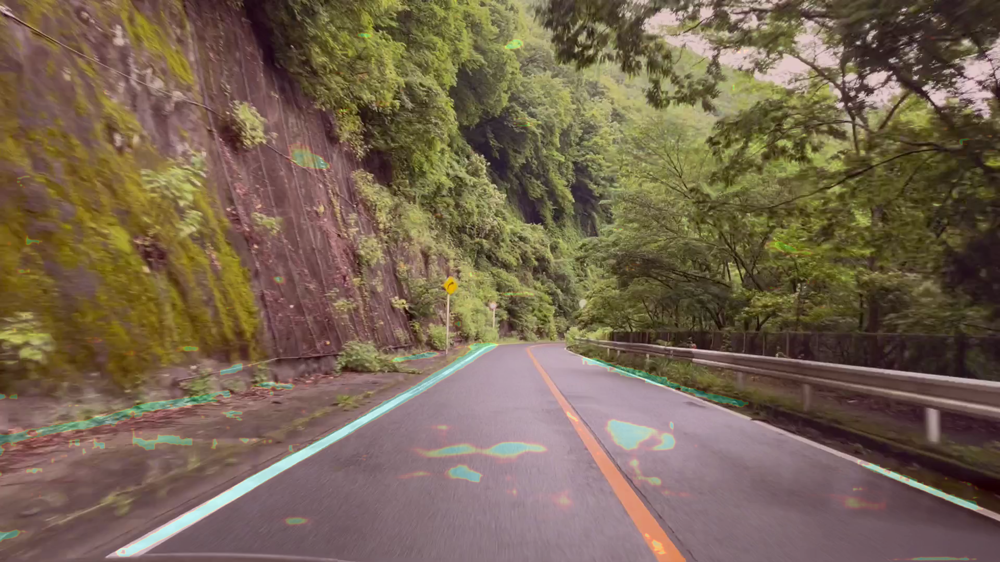

Shape of ll_seg_out: (640, 640)
Number of dimensions: 2


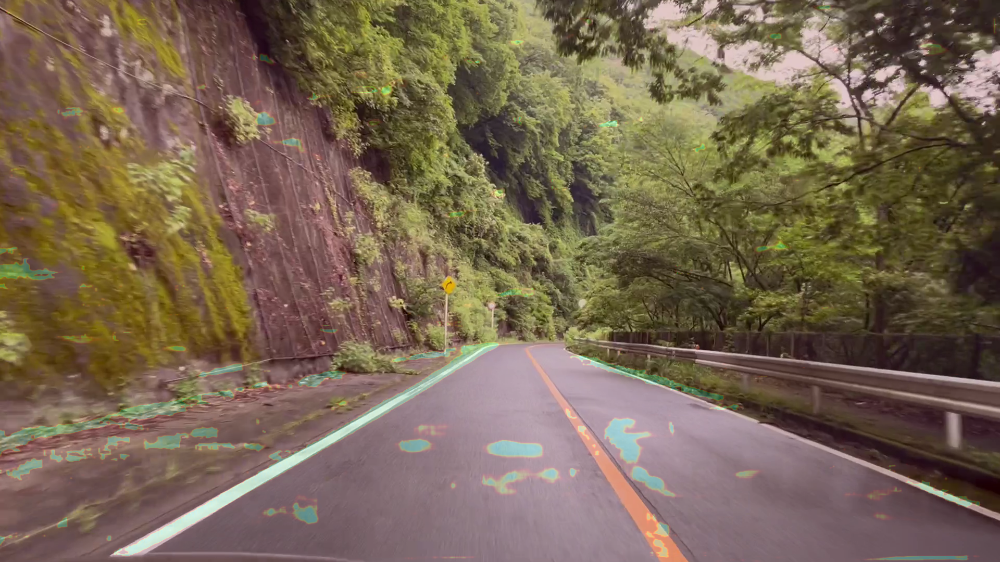

Shape of ll_seg_out: (640, 640)
Number of dimensions: 2


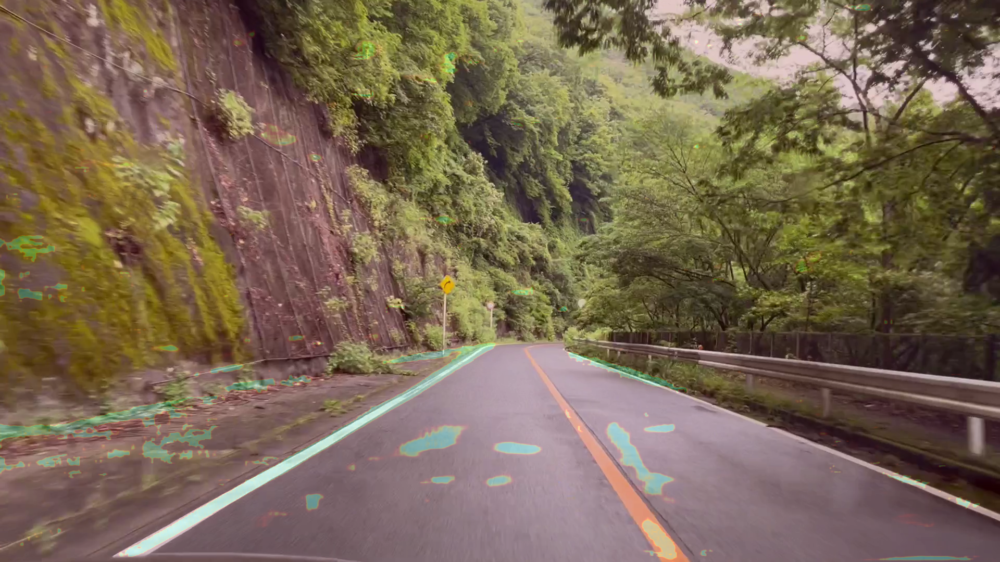

Shape of ll_seg_out: (640, 640)
Number of dimensions: 2


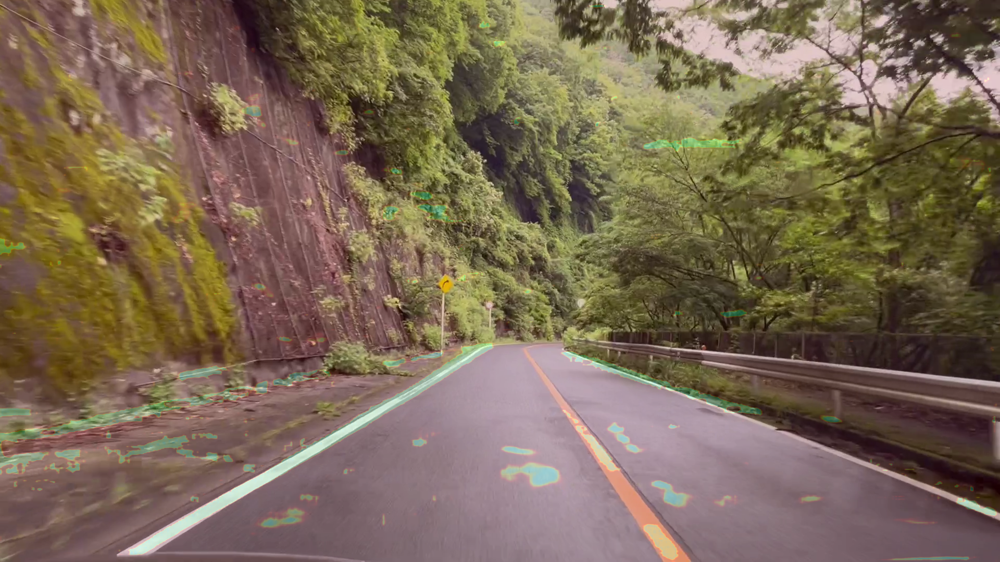

Shape of ll_seg_out: (640, 640)
Number of dimensions: 2


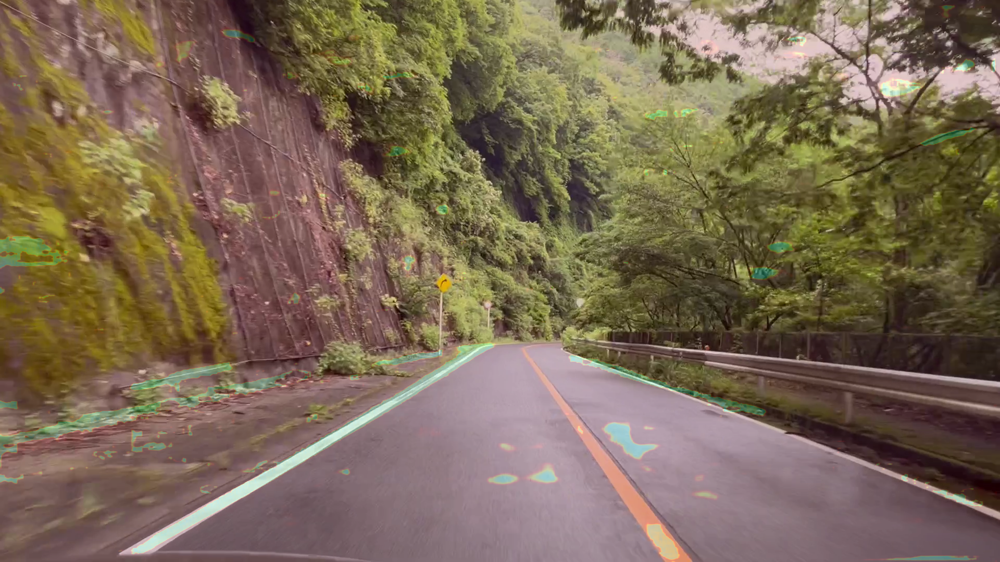

In [ ]:
import cv2
import torch
from google.colab.patches import cv2_imshow # Import the cv2_imshow function


# Load the pre-trained YOLOP model
model = torch.hub.load('hustvl/yolop', 'yolop', pretrained=True)

# Path to the input video
input_video_path = "/content/nD_20.mp4"

# Open the video file
cap = cv2.VideoCapture(input_video_path)
if not cap.isOpened():
    print("Error: Could not open the video file.")
    exit()

# Get video properties
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(cap.get(cv2.CAP_PROP_FPS))

# Output video writer
output_video_path = "output_with_lane_detection.mp4"
out = cv2.VideoWriter(output_video_path, cv2.VideoWriter_fourcc(*'mp4v'), fps, (frame_width, frame_height))

# Process the video frame by frame
while True:
    ret, frame = cap.read()
    if not ret:
        break  # End of video

    # Prepare the frame for the model (resize to 640x640)
    resized_frame = cv2.resize(frame, (640, 640))
    img = torch.from_numpy(resized_frame).permute(2, 0, 1).unsqueeze(0).float() / 255.0

    # Perform inference
    with torch.no_grad():
        det_out, da_seg_out, ll_seg_out = model(img)

    # Process the lane detection output (ll_seg_out) for visualization
    ll_seg_out = ll_seg_out.squeeze().cpu().numpy() * 255  # Convert to grayscale

    #Select the first channel (index 0) of 1l_seg_out
    ll_seg_out = ll_seg_out[0]  # Assuming the first channel represents lane detection

    # Print the shape and dimensions of ll_seg_out for debugging
    print("Shape of ll_seg_out:", ll_seg_out.shape)
    print("Number of dimensions:", ll_seg_out.ndim)

    # Check if ll_seg_out has valid dimensions before resizing
    if ll_seg_out.ndim == 2 and ll_seg_out.shape[0] > 0 and ll_seg_out.shape[1] > 0:
        ll_seg_out = cv2.resize(ll_seg_out, (frame_width, frame_height))  # Resize back to original frame size
    else:
        print("Warning: Skipping frame due to invalid ll_seg_out dimensions.")
        continue  # Skip the current frame

    # Overlay lane detection on the original frame
    ll_seg_colored = cv2.applyColorMap(ll_seg_out.astype('uint8'), cv2.COLORMAP_JET)
    overlaid_frame = cv2.addWeighted(frame, 0.8, ll_seg_colored, 0.2, 0)

    # Write the frame to the output video
    out.write(overlaid_frame)

    # Optional: Display the frame (press 'q' to quit early)
    cv2_imshow(overlaid_frame) # Use cv2_imshow instead of cv2.imshow
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release resources
cap.release()
out.release()
cv2.destroyAllWindows()

print(f"Processed video saved as {output_video_path}")

Using cache found in /root/.cache/torch/hub/hustvl_yolop_main
/root/.cache/torch/hub/hustvl_yolop_main/hubconf.py:23: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoin

Shape of ll_seg_out: (640, 640)
Number of dimensions: 2


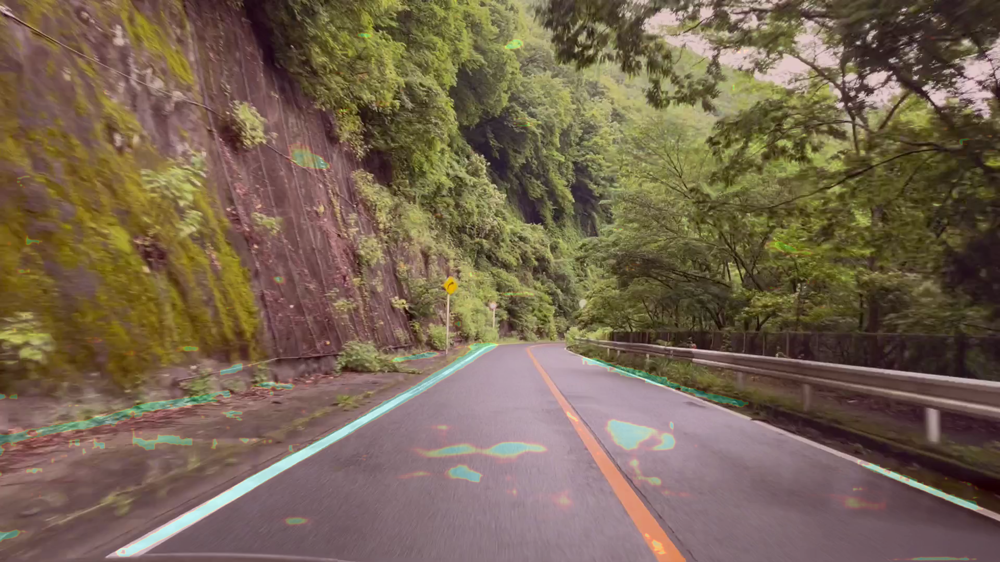

Shape of ll_seg_out: (640, 640)
Number of dimensions: 2


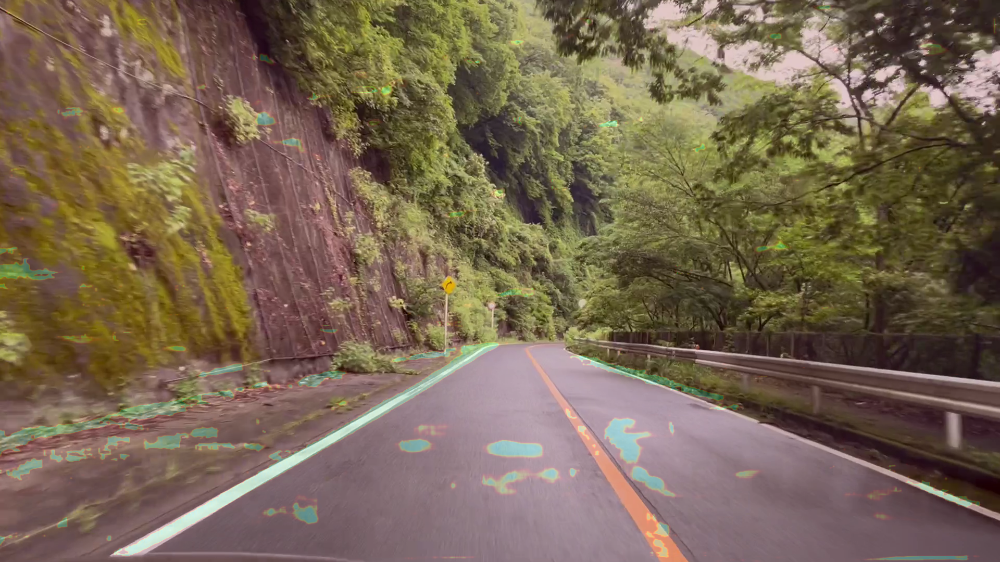

Shape of ll_seg_out: (640, 640)
Number of dimensions: 2


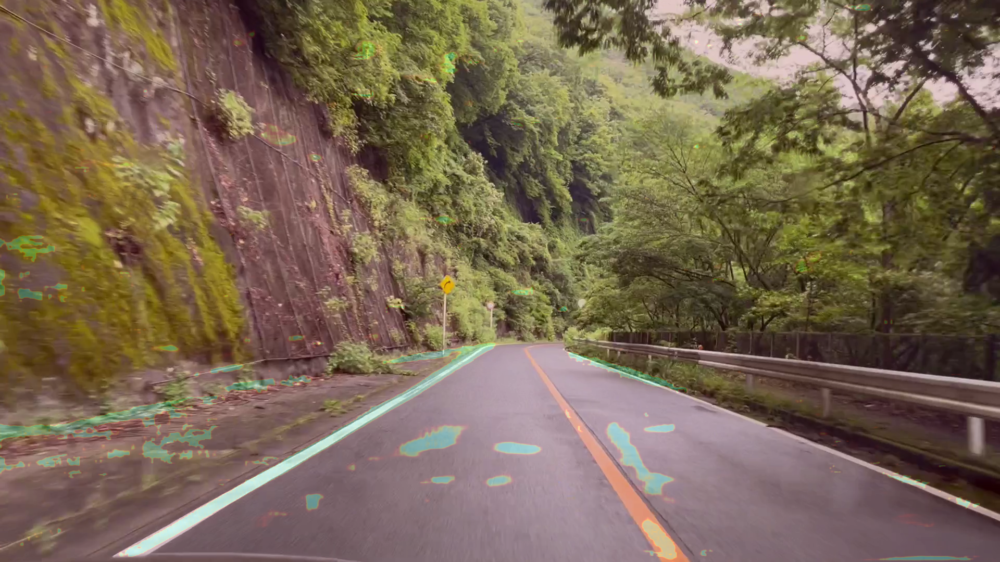

Shape of ll_seg_out: (640, 640)
Number of dimensions: 2


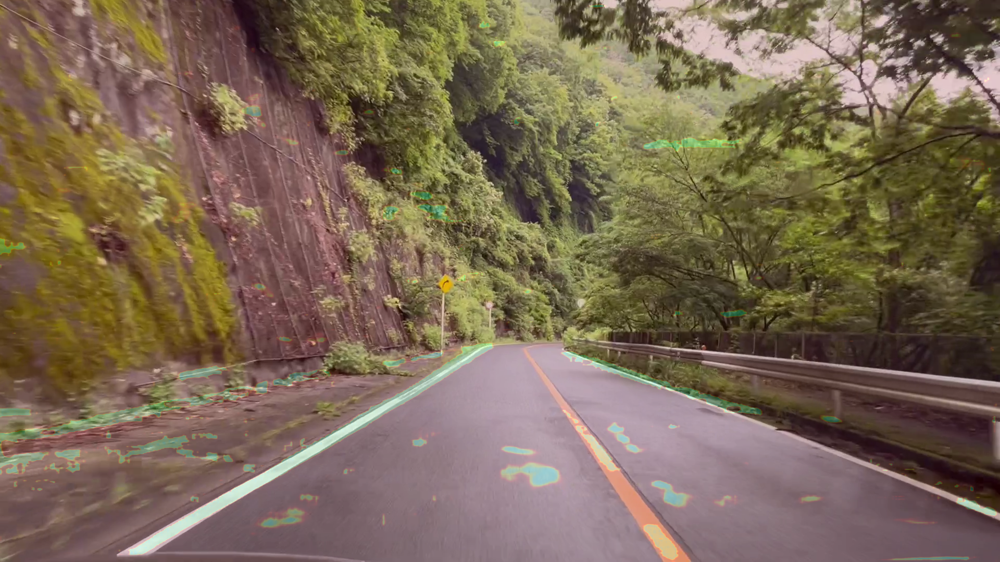

In [ ]:
import cv2
import torch
from google.colab.patches import cv2_imshow # Import the cv2_imshow function


# Load the pre-trained YOLOP model
model = torch.hub.load('hustvl/yolop', 'yolop', pretrained=True)

# Path to the input video
input_video_path = "/content/nD_20.mp4"

# Open the video file
cap = cv2.VideoCapture(input_video_path)
if not cap.isOpened():
    print("Error: Could not open the video file.")
    exit()

# Get video properties
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(cap.get(cv2.CAP_PROP_FPS))

# Output video writer
output_video_path = "output_with_lane_detection.mp4"
out = cv2.VideoWriter(output_video_path, cv2.VideoWriter_fourcc(*'mp4v'), fps, (frame_width, frame_height))

# Process the video frame by frame
while True:
    ret, frame = cap.read()
    if not ret:
        break  # End of video

    # Prepare the frame for the model (resize to 640x640)
    resized_frame = cv2.resize(frame, (640, 640))
    img = torch.from_numpy(resized_frame).permute(2, 0, 1).unsqueeze(0).float() / 255.0

    # Perform inference
    with torch.no_grad():
        det_out, da_seg_out, ll_seg_out = model(img)

    # Process the lane detection output (ll_seg_out) for visualization
    ll_seg_out = ll_seg_out.squeeze().cpu().numpy() * 255  # Convert to grayscale

    #Select the first channel (index 0) of 1l_seg_out
    ll_seg_out = ll_seg_out[0]  # Assuming the first channel represents lane detection

    # Print the shape and dimensions of ll_seg_out for debugging
    print("Shape of ll_seg_out:", ll_seg_out.shape)
    print("Number of dimensions:", ll_seg_out.ndim)

    # Check if ll_seg_out has valid dimensions before resizing
    if ll_seg_out.ndim == 2 and ll_seg_out.shape[0] > 0 and ll_seg_out.shape[1] > 0:
        ll_seg_out = cv2.resize(ll_seg_out, (frame_width, frame_height))  # Resize back to original frame size
    else:
        print("Warning: Skipping frame due to invalid ll_seg_out dimensions.")
        continue  # Skip the current frame

    # Overlay lane detection on the original frame
    ll_seg_colored = cv2.applyColorMap(ll_seg_out.astype('uint8'), cv2.COLORMAP_JET)
    overlaid_frame = cv2.addWeighted(frame, 0.8, ll_seg_colored, 0.2, 0)

    # Write the frame to the output video
    out.write(overlaid_frame)

    # Optional: Display the frame (press 'q' to quit early)
    cv2_imshow(overlaid_frame) # Use cv2_imshow instead of cv2.imshow
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release resources
cap.release()
out.release()
cv2.destroyAllWindows()

print(f"Processed video saved as {output_video_path}")

In [ ]:
import cv2
import torch
from google.colab.patches import cv2_imshow # Import the cv2_imshow function


# Load the pre-trained YOLOP model
model = torch.hub.load('hustvl/yolop', 'yolop', pretrained=True)

# Path to the input video
input_video_path = "/content/lane.mp4"

# Open the video file
cap = cv2.VideoCapture(input_video_path)
if not cap.isOpened():
    print("Error: Could not open the video file.")
    exit()

# Get video properties
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(cap.get(cv2.CAP_PROP_FPS))

# Output video writer
output_video_path = "output_with_lane_detection.mp4"
out = cv2.VideoWriter(output_video_path, cv2.VideoWriter_fourcc(*'mp4v'), fps, (frame_width, frame_height))

# Process the video frame by frame
while True:
    ret, frame = cap.read()
    if not ret:
        break  # End of video

    # Prepare the frame for the model (resize to 640x640)
    resized_frame = cv2.resize(frame, (640, 640))
    img = torch.from_numpy(resized_frame).permute(2, 0, 1).unsqueeze(0).float() / 255.0

    # Perform inference
    with torch.no_grad():
        det_out, da_seg_out, ll_seg_out = model(img)

    # Process the lane detection output (ll_seg_out) for visualization
    ll_seg_out = ll_seg_out.squeeze().cpu().numpy() * 255  # Convert to grayscale

    #Select the first channel (index 0) of 1l_seg_out
    ll_seg_out = ll_seg_out[0]  # Assuming the first channel represents lane detection

    # Print the shape and dimensions of ll_seg_out for debugging
    print("Shape of ll_seg_out:", ll_seg_out.shape)
    print("Number of dimensions:", ll_seg_out.ndim)

    # Check if ll_seg_out has valid dimensions before resizing
    if ll_seg_out.ndim == 2 and ll_seg_out.shape[0] > 0 and ll_seg_out.shape[1] > 0:
        ll_seg_out = cv2.resize(ll_seg_out, (frame_width, frame_height))  # Resize back to original frame size
    else:
        print("Warning: Skipping frame due to invalid ll_seg_out dimensions.")
        continue  # Skip the current frame

    # Overlay lane detection on the original frame
    ll_seg_colored = cv2.applyColorMap(ll_seg_out.astype('uint8'), cv2.COLORMAP_JET)
    overlaid_frame = cv2.addWeighted(frame, 0.8, ll_seg_colored, 0.2, 0)

    # Write the frame to the output video
    out.write(overlaid_frame)

    # Optional: Display the frame (press 'q' to quit early)
    cv2_imshow(overlaid_frame) # Use cv2_imshow instead of cv2.imshow
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release resources
cap.release()
out.release()
cv2.destroyAllWindows()

print(f"Processed video saved as {output_video_path}")

### Citation

See for more detail in [github code](https://github.com/hustvl/YOLOP) and [arxiv paper](https://arxiv.org/abs/2108.11250).

If you find our paper and code useful for your research, please consider giving a star and citation: